<h1 style="text-align:center"> Drexel University </h1>
<h2 style = "text-align:center"> College of Computing and Informatics</h2>
<h2 style = "text-align:center">INFO 213: Data Science Programming II</h2>
<h3 style = "text-align:center">Exploratory Data Analytics - Group 4</h3>

</div>

<h3 style = "text-align:center"> NAME: Quan Ta, Steven Nie, Kayla Savage, Tapasya Sharma </h3>


In [1]:
# Author: Kayla Savage, Tapasya Sharma, Quan Ta and Steven Nie
# Date : January 30th, 2022
# Purpose: File cleans data for INFO 442 project

In [2]:
#Revision Edits: For EDA Purposes - Added fill_mean function to all numeric features and added EDA

In [74]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas_profiling
import scipy as sp
import statistics as st
%matplotlib inline

In [75]:
#get the current directory
curDir = os.getcwd()
print(curDir)

C:\Users\sharm\Desktop\Drexel\Class-work-\Winter 21-22\INFO 442\EDA file


In [76]:
#change to the name of the data file in your folder
df = pd.read_csv(r"merged_data.csv", encoding = 'latin1')

In [77]:
df.head()

,Date,Symbol,apturnover,arturnover,assetturnover,croic,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,...,profitmargin,roe_simple,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price
0,2020-12-30,RSI,NaN,16.1314,1.6674,NaN,0.231097,0.7344,-4.970785,NaN,...,-0.472693,2.130902,0.000000,663437419.9,United States of America,NaN,FALSE,7990,21.13,9.00
1,2020-12-24,VTAQ,NaN,NaN,NaN,NaN,-0.043767,7.9669,NaN,NaN,...,NaN,0.214396,0.000826,191788580.6,United States of America,4.0,FALSE,6770,10.29,10.07
2,2020-12-23,PHAR,NaN,5.4113,0.5199,-0.325334,0.340220,5.5220,-0.037194,NaN,...,0.230894,0.227771,0.000000,9838328205,Netherlands,258.0,FALSE,2834,19.19,8.79
3,2020-12-23,VHAQ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,United States of America,2.0,FALSE,6770,10.15,10.04
4,2020-12-22,XL,7.1506,3.4712,0.1142,NaN,0.998900,38.0183,-3.426013,NaN,...,-2.979939,-0.320843,0.000582,1677155081,United States of America,NaN,FALSE,3714,18.89,2.07


In [78]:
df.shape

(4620, 30)

In [79]:
#getting a list of all the columns currently present
df.columns

Index(['Date', 'Symbol', 'apturnover', 'arturnover', 'assetturnover', 'croic',
       'commontocap', 'currentratio', 'ebitdagrowth', 'ebitdaqoqgrowth',
       'efftaxrate', 'fcffgrowth', 'fcffqoqgrowth', 'fcfftointerestex',
       'grossmargin', 'investedcapitalturnover', 'leverageratio',
       'Itdebttocap', 'nnep', 'operatingmargin', 'profitmargin', 'roe_simple',
       'stdebttocap', 'enterprisevalue', 'country', 'employees',
       'security_delisted', 'sic', 'ipo_price', 'current_price'],
      dtype='object')

In [80]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4620 entries, 0 to 4619
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Date                     4620 non-null   object 
 1   Symbol                   4620 non-null   object 
 2   apturnover               1843 non-null   object 
 3   arturnover               1984 non-null   object 
 4   assetturnover            2731 non-null   object 
 5   croic                    1988 non-null   object 
 6   commontocap              3310 non-null   float64
 7   currentratio             2906 non-null   float64
 8   ebitdagrowth             2921 non-null   float64
 9   ebitdaqoqgrowth          886 non-null    float64
 10  efftaxrate               1365 non-null   object 
 11  fcffgrowth               2318 non-null   float64
 12  fcffqoqgrowth            125 non-null    object 
 13  fcfftointerestex         1822 non-null   float64
 14  grossmargin             

In [81]:
#seeing general stastics for each numerical column 
df.iloc[:, 0:26].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
commontocap,3310.0,0.875711,5.528982,-51.381076,0.422717,0.866105,1.000000,113.596884
currentratio,2906.0,7.612065,39.486587,0.000000,1.608400,3.074700,7.992400,1464.475000
ebitdagrowth,2921.0,-55.358344,1923.517897,-99654.760670,-1.056557,-0.140375,0.318925,10811.742940
ebitdaqoqgrowth,886.0,-5.035847,122.093783,-3616.187500,-0.218770,-0.023587,0.103856,15.081761
fcffgrowth,2318.0,-1.587792,13.257807,-239.037071,-1.517253,0.077280,0.985123,152.040199
fcfftointerestex,1822.0,-21.994072,6047.776178,-42640.000000,-31.246500,-6.830750,0.532875,250679.057700
grossmargin,2485.0,0.447264,4.545217,-186.398683,0.330525,0.598854,0.892803,2.998380
nnep,3297.0,-1.126656,174.747138,-8607.014468,-0.182620,-0.006773,0.056151,5052.276959
roe_simple,3245.0,-0.092131,3.718265,-39.759611,-0.397572,-0.087104,0.080120,49.656790
stdebttocap,3311.0,-0.021251,1.479338,-68.961671,0.000000,0.000000,0.022257,7.033963


In [82]:
#counting the number of null values in each column
pd.isnull(df).sum()

Date                          0
Symbol                        0
apturnover                 2777
arturnover                 2636
assetturnover              1889
croic                      2632
commontocap                1310
currentratio               1714
ebitdagrowth               1699
ebitdaqoqgrowth            3734
efftaxrate                 3255
fcffgrowth                 2302
fcffqoqgrowth              4495
fcfftointerestex           2798
grossmargin                2135
investedcapitalturnover    1893
leverageratio              1289
Itdebttocap                4618
nnep                       1323
operatingmargin            2134
profitmargin               1802
roe_simple                 1375
stdebttocap                1309
enterprisevalue            1453
country                     798
employees                  1512
security_delisted           666
sic                         673
ipo_price                   465
current_price              1796
dtype: int64

In [83]:
#Finding any duplicated values - there are no duplicates here
df[df.duplicated()]

,Date,Symbol,apturnover,arturnover,assetturnover,croic,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,...,profitmargin,roe_simple,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price
311,2017-08-24,NEWA,4.6099,5.1966,0.8052,-0.464849,0.699173,1.2995,0.033153,NaN,...,0.102249,0.123429,0.300459,NaN,China,NaN,TRUE,4950,1.100000e+01,NaN
312,2017-07-28,NEWA,4.6099,5.1966,0.8052,-0.464849,0.699173,1.2995,0.033153,NaN,...,0.102249,0.123429,0.300459,NaN,China,NaN,TRUE,4950,1.100000e+01,NaN
314,2017-08-17,NETS,3.5259,11.0877,1.3951,0.06233,0.628385,1.6144,0.173252,NaN,...,-0.09282,-0.352368,0.000000,78235891,Brazil,NaN,FALSE,5961,1.488000e+01,NaN
315,2017-07-24,NETS,3.5259,11.0877,1.3951,0.06233,0.628385,1.6144,0.173252,NaN,...,-0.09282,-0.352368,0.000000,78235891,Brazil,NaN,FALSE,5961,1.488000e+01,NaN
340,2017-05-05,BDFC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,Canada,NaN,FALSE,2090,1.000000e-04,NaN
341,2017-05-04,BDFC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,Canada,NaN,FALSE,2090,1.000000e-04,NaN
343,2017-08-08,CVNA,19.2507,86.7677,1.7582,-0.759257,0.049162,1.6002,-0.690209,NaN,...,-0.191316,-1.306833,0.436342,657584920,United States of America,3879.0,FALSE,5500,1.875000e+01,146.530000
344,2017-04-28,CVNA,19.2507,86.7677,1.7582,-0.759257,0.049162,1.6002,-0.690209,NaN,...,-0.191316,-1.306833,0.436342,657584920,United States of America,3879.0,FALSE,5500,1.875000e+01,146.530000
345,2017-04-24,CVNA,19.2507,86.7677,1.7582,-0.759257,0.049162,1.6002,-0.690209,NaN,...,-0.191316,-1.306833,0.436342,657584920,United States of America,3879.0,FALSE,5500,1.875000e+01,146.530000
347,2017-08-08,CVNA,19.2507,86.7677,1.7582,-0.759257,0.049162,1.6002,-0.690209,NaN,...,-0.191316,-1.306833,0.436342,657584920,United States of America,3879.0,FALSE,5500,1.875000e+01,146.530000


In [84]:
df = df.dropna(subset = ['Symbol', 'sic'])

In [85]:
def missing_data_ticker(df,threshold):
    
    """
    
    Function to remove rows that have missing data beyond threshold for each ticker 
    
    Parameters:
    
    df - df to be modified
    threshold - threshold in percentage of clean data. Higher the percentage, lesser na values
    
    """
    threshold = df.shape[1] * (threshold/100) 
    df.dropna(thresh = threshold, axis = 0, inplace = True)
    
    return df

In [86]:
def missing_data_column(df,threshold):
    
    """
    
    Function to remove columns that have missing data beyond threshold for each column
    
    Parameters:
    
    df - df to be modified
    threshold - threshold in percentage of clean data. Higher the percentage, lesser na values
    
    """
    threshold = df.shape[0] * (threshold/100) 
    df.dropna(thresh = threshold, axis = 1, inplace = True)

    return df
    

In [87]:
def duplicate_symbols(df,column):
    """
    This function removes any duplicated symbols in the specified column
    
    Parameters:
    
    df - df of which symbols have to removed
    column - Name of column to check
    
    """
    duplicated_data = df[column].duplicated().sum() 
    df.drop_duplicates(subset = column, keep = False, inplace = True)
    
    return df
    
    
    

In [88]:
def null_employee(df,column):
    """
    This function set the column value to O if it is currently null 
    
    Parameters:
    
    df - df to be modified
    column - Name of column to check
    
    """
        
    df.loc[(df[column] == '') | (df[column] == None) | (df[column].isnull()), column] = 0  
    return df
    
    

In [89]:
def current_price(df, col1, col2):
    
    """if the current price column is empty then the security
    delisted is True and set the current price is 0

    Parameters:

    df - df to be modified

    """

    df.loc[(df[col1] == '') | (df[col1] == None) | (df[col1].isnull()), col2] = True  
    df.loc[(df[col1] == '') | (df[col1] == None) | (df[col1].isnull()), col1] = 1
    
    return df



In [90]:
def success_req(df, col1, col2, target_col):
    
    """
    This function checks and modifies requirements for success/failure of target value

    Parameters:

    df - df to be modified
    col1 - First column to check requirement
    col2 - First column to check requirement
    target_col - Target Columm

    """
        
    #STOCK SUCCESS REQUIREMENTS - if delisted then stock success is False
    df.loc[(df[col1] == 0), target_col] = False
    #current price is equal or lower than 50% of the ipo price it is False
    df.loc[(df[col1] == df[col2]), target_col] = False
    #check logic
    df.loc[(df[col1] < df[col2]/ 2), target_col]
    
    return df

In [20]:
def fill_mean(df, col1):
    """
    Parameters: 
    df - df to be modified
    col1 - First column to check and fill mean 
    """
    df[col1] = df[col1].fillna(df.groupby('sic')[col1].transform('mean'))
    
    return df
        

In [21]:
#Adding the Success target variable column - Boolean value (True/False)
NaN = np.nan
df["success"] = NaN

In [22]:
df.dtypes

Date                        object
Symbol                      object
apturnover                  object
arturnover                  object
assetturnover               object
croic                       object
commontocap                float64
currentratio               float64
ebitdagrowth               float64
ebitdaqoqgrowth            float64
efftaxrate                  object
fcffgrowth                 float64
fcffqoqgrowth               object
fcfftointerestex           float64
grossmargin                float64
investedcapitalturnover     object
leverageratio               object
Itdebttocap                 object
nnep                       float64
operatingmargin             object
profitmargin                object
roe_simple                 float64
stdebttocap                float64
enterprisevalue             object
country                     object
employees                  float64
security_delisted           object
sic                         object
ipo_price           

In [23]:
fill_mean(df, "commontocap")
fill_mean(df, "currentratio")
fill_mean(df, "ebitdagrowth")
fill_mean(df, "ebitdaqoqgrowth")
fill_mean(df, "fcffgrowth")
fill_mean(df, "fcfftointerestex")
fill_mean(df, "grossmargin")
fill_mean(df, "nnep")
fill_mean(df, "roe_simple")
fill_mean(df, "stdebttocap")
fill_mean(df, "ipo_price")
fill_mean(df, "current_price")

,Date,Symbol,apturnover,arturnover,assetturnover,croic,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,...,roe_simple,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success
0,2020-12-30,RSI,NaN,16.1314,1.6674,NaN,0.231097,0.734400,-4.970785,-0.069725,...,2.130902,0.000000,663437419.9,United States of America,NaN,FALSE,7990,21.130000,9.000000,NaN
1,2020-12-24,VTAQ,NaN,NaN,NaN,NaN,-0.043767,7.966900,-696.592147,1.039494,...,0.214396,0.000826,191788580.6,United States of America,4.0,FALSE,6770,10.290000,10.070000,NaN
2,2020-12-23,PHAR,NaN,5.4113,0.5199,-0.325334,0.340220,5.522000,-0.037194,-20.545706,...,0.227771,0.000000,9838328205,Netherlands,258.0,FALSE,2834,19.190000,8.790000,NaN
3,2020-12-23,VHAQ,NaN,NaN,NaN,NaN,0.139743,9.430820,-696.592147,1.039494,...,-0.094776,-0.104405,NaN,United States of America,2.0,FALSE,6770,10.150000,10.040000,NaN
4,2020-12-22,XL,7.1506,3.4712,0.1142,NaN,0.998900,38.018300,-3.426013,-2.499642,...,-0.320843,0.000582,1677155081,United States of America,NaN,FALSE,3714,18.890000,2.070000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4613,2012-05-10,ADNC,7.1319,13.4547,1.3039,0.966075,1.000000,6.416000,0.737988,0.187756,...,0.106876,0.000000,35349930,United States of America,319.0,TRUE,3674,19.000000,31.749821,NaN
4614,2012-04-27,EDG,2.6535,7.0184,0.3407,-0.021939,0.703960,1.653700,-0.208686,15.081761,...,0.110320,0.004761,8156529071,South Africa,8964.0,FALSE,1040,10.350000,7.535000,NaN
4616,2012-04-18,SDR,NaN,NaN,NaN,NaN,0.583302,4.399244,0.956547,0.450718,...,-0.128106,0.005250,NaN,United States of America,9.0,FALSE,1311,4.683877,25.206667,NaN
4617,2019-02-14,NFE,7.6779,4.8234,0.2075,-0.853604,0.084267,2.064500,-2.423248,-0.075189,...,-2.409280,0.000000,1184744258,United States of America,140.0,FALSE,4924,13.795891,20.970000,NaN


In [24]:
missing_data_ticker(df,20)
missing_data_column(df,20)
duplicate_symbols(df, "Symbol")
null_employee(df, "employees")
current_price(df, "current_price", "security_delisted")
success_req(df, "current_price", "ipo_price", "success")

,Date,Symbol,apturnover,arturnover,assetturnover,croic,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,...,roe_simple,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success
0,2020-12-30,RSI,NaN,16.1314,1.6674,NaN,0.231097,0.734400,-4.970785,-0.069725,...,2.130902,0.000000,663437419.9,United States of America,0.0,FALSE,7990,21.130000,9.000000,NaN
1,2020-12-24,VTAQ,NaN,NaN,NaN,NaN,-0.043767,7.966900,-696.592147,1.039494,...,0.214396,0.000826,191788580.6,United States of America,4.0,FALSE,6770,10.290000,10.070000,NaN
2,2020-12-23,PHAR,NaN,5.4113,0.5199,-0.325334,0.340220,5.522000,-0.037194,-20.545706,...,0.227771,0.000000,9838328205,Netherlands,258.0,FALSE,2834,19.190000,8.790000,NaN
3,2020-12-23,VHAQ,NaN,NaN,NaN,NaN,0.139743,9.430820,-696.592147,1.039494,...,-0.094776,-0.104405,NaN,United States of America,2.0,FALSE,6770,10.150000,10.040000,NaN
4,2020-12-22,XL,7.1506,3.4712,0.1142,NaN,0.998900,38.018300,-3.426013,-2.499642,...,-0.320843,0.000582,1677155081,United States of America,0.0,FALSE,3714,18.890000,2.070000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4612,2012-05-11,IRG,19.3188,65.8114,2.4524,0.019854,0.702414,0.654000,0.170757,0.171005,...,0.082040,0.000000,341348000,NaN,461.0,TRUE,5812,16.850000,50.813333,NaN
4613,2012-05-10,ADNC,7.1319,13.4547,1.3039,0.966075,1.000000,6.416000,0.737988,0.187756,...,0.106876,0.000000,35349930,United States of America,319.0,TRUE,3674,19.000000,31.749821,NaN
4614,2012-04-27,EDG,2.6535,7.0184,0.3407,-0.021939,0.703960,1.653700,-0.208686,15.081761,...,0.110320,0.004761,8156529071,South Africa,8964.0,FALSE,1040,10.350000,7.535000,NaN
4616,2012-04-18,SDR,NaN,NaN,NaN,NaN,0.583302,4.399244,0.956547,0.450718,...,-0.128106,0.005250,NaN,United States of America,9.0,FALSE,1311,4.683877,25.206667,NaN


In [25]:
df['price_change_rate'] = (df['current_price'] - df['ipo_price'])/df['ipo_price']*100
df['price_change_rate']

0       -57.406531
1        -2.137998
2       -54.194893
3        -1.083744
4       -89.041821
           ...    
4612    201.562809
4613     67.104319
4614    -27.198068
4616    438.158149
4619    -47.473684
Name: price_change_rate, Length: 1301, dtype: float64

In [26]:
#Percentage of growth in price of increasing stocks

df.loc[df['price_change_rate'] > 0, 'price_change_rate'].sum() / (df['price_change_rate'] > 0).sum()

1668.714624490896

In [27]:
#Percentage of growth in price of decreasing stocks

df.loc[df['price_change_rate'] < 0, 'price_change_rate'].sum() / (df['price_change_rate'] < 0).sum()

-49.87300492252535

In [28]:
#Percentage of growth in price of all stocks

df['price_change_rate'].sum() / df['price_change_rate'].count()

553.9272761356615

In [29]:
#distribution of country of ipo

df.country.value_counts()

United States of America       981
China                          110
United Kingdom                  19
Canada                          19
Israel                          18
Cayman Islands                  13
Germany                          8
France                           8
Hong Kong                        7
Netherlands                      6
Singapore                        5
Bermuda                          5
Brazil                           5
Australia                        5
Luxembourg                       5
Ireland                          3
Switzerland                      3
Mexico                           3
Denmark                          2
South Africa                     2
Argentina                        2
Georgia                          2
Belgium                          2
Japan                            2
CANADA                           1
Norway                           1
United Arab Emirates             1
Puerto Rico                      1
Panama              

In [30]:
#Number of countries that have ipo
df.country.value_counts().count()

45

In [31]:
#Number of countries that have more than 1 ipo

df.country.value_counts()[df.country.value_counts() > 1].count()

24

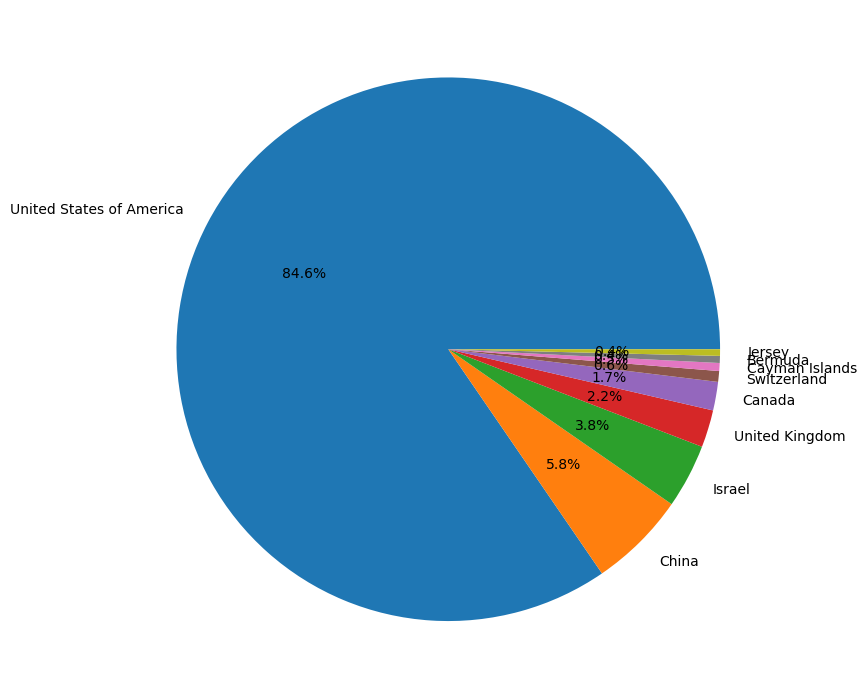

In [91]:
#Country wise distribution for top 10 countires
plt.figure(figsize=(9, 9), dpi=100)
plt.pie(df.country.value_counts()[:9], labels=df.country.value_counts()[:9].index, autopct='%1.1f%%')
plt.show()

### Defining which companies are and are not successful

In [92]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3947 entries, 0 to 4619
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Date                     3947 non-null   object 
 1   Symbol                   3947 non-null   object 
 2   apturnover               1842 non-null   object 
 3   arturnover               1982 non-null   object 
 4   assetturnover            2729 non-null   object 
 5   croic                    1986 non-null   object 
 6   commontocap              3308 non-null   float64
 7   currentratio             2904 non-null   float64
 8   ebitdagrowth             2919 non-null   float64
 9   ebitdaqoqgrowth          885 non-null    float64
 10  efftaxrate               1364 non-null   object 
 11  fcffgrowth               2316 non-null   float64
 12  fcffqoqgrowth            125 non-null    object 
 13  fcfftointerestex         1820 non-null   float64
 14  grossmargin             

In [93]:
df = df.replace('api_500',np.NaN)
cols = ['assetturnover', 'efftaxrate', 'leverageratio', 'profitmargin', 'enterprisevalue',  ]
for i in cols: 
    df[i] = df[i].astype(float)

In [94]:
for index, row in df.iterrows():
    if row['current_price'] <= row['ipo_price']*0.5 or row['security_delisted'] is True:
        df.loc[index,'success'] = False
    else:
        df.loc[index,'success'] = True

In [95]:
df['success'].value_counts()

True     2980
False     967
Name: success, dtype: int64

We can see the number of sucess company is 423 and failed company is 483

In [96]:
sic_dict = df['sic'].value_counts().nlargest(20).to_dict()

In [97]:
sic_dict

{'2834': 795,
 '7372': 322,
 '6770': 280,
 '2836': 160,
 '6798': 111,
 '3841': 100,
 '6022': 100,
 '1311': 93,
 '7374': 87,
 '7389': 82,
 '7370': 62,
 '6199': 60,
 '3674': 49,
 '3842': 47,
 '6021': 37,
 '6282': 37,
 '5961': 36,
 '8071': 36,
 '4922': 36,
 '5812': 33}

We now want to analyze different industry's success rate, there are over 100 differnt unique industry present here to we just going to select the 20 most common industry type. The industry code used here is a code used by SEC to classify different company, for the meaning of these code we can go to https://www.sec.gov/corpfin/division-of-corporation-finance-standard-industrial-classification-sic-code-list

In [98]:
sic_data = {}
for sic in sic_dict.keys():
    success_sic = df[(df['success'] == True) & (df['sic'] == sic)]['sic'].count() # get the number of cases where the sic is success or failed
    failed_sic = df[(df['success'] == False) & (df['sic'] == sic)]['sic'].count() 
    
    success_rate = format(success_sic / (success_sic + failed_sic), '.2%')  # use x = 0.3333 format(x,'.2%') to format it to percentgae number

    sic_data.update({sic: success_rate})
    

In [99]:
sic_data

{'2834': '51.95%',
 '7372': '92.24%',
 '6770': '96.43%',
 '2836': '58.13%',
 '6798': '98.20%',
 '3841': '80.00%',
 '6022': '100.00%',
 '1311': '93.55%',
 '7374': '79.31%',
 '7389': '80.49%',
 '7370': '75.81%',
 '6199': '43.33%',
 '3674': '61.22%',
 '3842': '34.04%',
 '6021': '100.00%',
 '6282': '97.30%',
 '5961': '83.33%',
 '8071': '69.44%',
 '4922': '100.00%',
 '5812': '78.79%'}

We now can see the success rate of the top 20 most common industry, we can see the most common industry 2834 which is PHARMACEUTICAL PREPARATIONS has a 31% success rate, some of the highest success rate industry like 6022 is STATE COMMERCIAL BANKS, 6282 INVESTMENT ADVICE, 6021 NATIONAL COMMERCIAL BANKS. 

Some of the industry with the lowest success rate is 8200 SERVICES-EDUCATIONAL SERVICES, 5961 RETAIL-CATALOG & MAIL-ORDER HOUSES, 6199 FINANCE SERVICES

In [100]:
df.isna().sum()

Date                          0
Symbol                        0
apturnover                 2107
arturnover                 1966
assetturnover              1220
croic                      1962
commontocap                 639
currentratio               1043
ebitdagrowth               1028
ebitdaqoqgrowth            3062
efftaxrate                 2586
fcffgrowth                 1631
fcffqoqgrowth              3823
fcfftointerestex           2127
grossmargin                1464
investedcapitalturnover    1223
leverageratio               619
Itdebttocap                3947
nnep                        652
operatingmargin            1464
profitmargin               1134
roe_simple                  704
stdebttocap                 638
enterprisevalue             783
country                     157
employees                   845
security_delisted            21
sic                           4
ipo_price                   192
current_price              1349
success                       0
dtype: i

Base on the amount of missing data per column we can remove some column that has too many missing value for a more accurate analysis, we can remove apturnover, arturnover, fcfftointerestex, fcffgrowth, croic, grossmargin, operatingmargin. These are column that have more than 200 missing value

In [101]:
df = df.drop('apturnover', 1)
df = df.drop('arturnover', 1)
df = df.drop('fcfftointerestex', 1)
df = df.drop('fcffgrowth', 1)
df = df.drop('croic', 1)
df = df.drop('grossmargin', 1)
df = df.drop('operatingmargin', 1)

In [102]:
df.isna().sum()

Date                          0
Symbol                        0
assetturnover              1220
commontocap                 639
currentratio               1043
ebitdagrowth               1028
ebitdaqoqgrowth            3062
efftaxrate                 2586
fcffqoqgrowth              3823
investedcapitalturnover    1223
leverageratio               619
Itdebttocap                3947
nnep                        652
profitmargin               1134
roe_simple                  704
stdebttocap                 638
enterprisevalue             783
country                     157
employees                   845
security_delisted            21
sic                           4
ipo_price                   192
current_price              1349
success                       0
dtype: int64

In [103]:
df['investedcapitalturnover'] = df['investedcapitalturnover'].astype(float)

In [104]:
df_success = df[df['success'] == True].copy()
df_failed = df[df['success'] == False].copy()

Now we would like to see the difference in metrics data distribution for successful and failed company so we have a idea what the metric distribution looks like for a successful and failed company

In [105]:
df_success.head()

,Date,Symbol,assetturnover,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,efftaxrate,fcffqoqgrowth,investedcapitalturnover,...,roe_simple,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success
1,2020-12-24,VTAQ,NaN,-0.043767,7.9669,NaN,NaN,NaN,NaN,NaN,...,0.214396,0.000826,191788580.6,United States of America,4.0,FALSE,6770,10.29,10.070,True
3,2020-12-23,VHAQ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,United States of America,2.0,FALSE,6770,10.15,10.040,True
5,2020-12-18,SVOK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,United States of America,4.0,TRUE,6770,10.50,11.090,True
7,2020-12-17,SCOA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,United States of America,3.0,FALSE,6770,10.77,9.750,True
8,2020-12-16,CCV,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,United States of America,2.0,FALSE,6770,12.50,9.785,True


In [106]:
df_failed.head()

,Date,Symbol,assetturnover,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,efftaxrate,fcffqoqgrowth,investedcapitalturnover,...,roe_simple,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success
0,2020-12-30,RSI,1.6674,0.231097,0.7344,-4.970785,NaN,NaN,NaN,-1.0316,...,2.130902,0.000000,6.634374e+08,United States of America,NaN,FALSE,7990,21.13,9.00,False
2,2020-12-23,PHAR,0.5199,0.340220,5.5220,-0.037194,NaN,0.143971,NaN,0.8098,...,0.227771,0.000000,9.838328e+09,Netherlands,258.0,FALSE,2834,19.19,8.79,False
4,2020-12-22,XL,0.1142,0.998900,38.0183,-3.426013,NaN,NaN,NaN,-0.2795,...,-0.320843,0.000582,1.677155e+09,United States of America,NaN,FALSE,3714,18.89,2.07,False
6,2020-12-18,MASS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,5.979562e+08,United States of America,96.0,FALSE,3829,45.51,14.46,False
13,2020-12-11,VVOS,0.7948,0.929146,2.6070,-0.145210,NaN,NaN,NaN,17.0705,...,-0.712693,0.047616,9.071802e+07,United States of America,97.0,FALSE,3841,7.07,2.81,False


In [107]:
pd.set_option("display.max_rows", None)

In [108]:
df.columns

Index(['Date', 'Symbol', 'assetturnover', 'commontocap', 'currentratio',
       'ebitdagrowth', 'ebitdaqoqgrowth', 'efftaxrate', 'fcffqoqgrowth',
       'investedcapitalturnover', 'leverageratio', 'Itdebttocap', 'nnep',
       'profitmargin', 'roe_simple', 'stdebttocap', 'enterprisevalue',
       'country', 'employees', 'security_delisted', 'sic', 'ipo_price',
       'current_price', 'success'],
      dtype='object')

<AxesSubplot:ylabel='Density'>

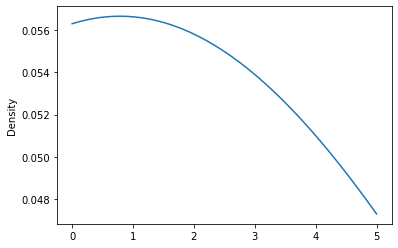

In [109]:
df_success['assetturnover'].plot.density(ind=np.linspace(0, 5))

<AxesSubplot:ylabel='Density'>

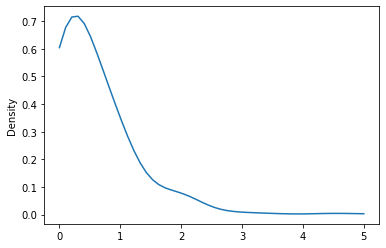

In [110]:
df_failed['assetturnover'].plot.density(ind=np.linspace(0, 5))

Asset turnover measure the efficency of asset use, it doesnt seems like there is a major differnce between success and failed company except for successful company tend to have higher asset turnover

<AxesSubplot:ylabel='Density'>

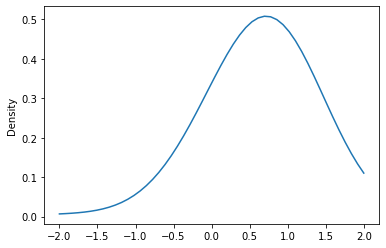

In [111]:
df_success['commontocap'].plot.density(ind=np.linspace(-2, 2))

<AxesSubplot:ylabel='Density'>

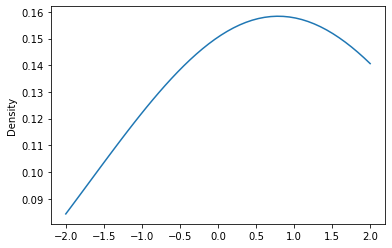

In [112]:
df_failed['commontocap'].plot.density(ind=np.linspace(-2, 2))

Commontocap is common equity to total capital, it is a indication of the capital strcuture of the company basically how much of the company is being owned by outsider investor with regular equity, we can see successful company 

<AxesSubplot:ylabel='Density'>

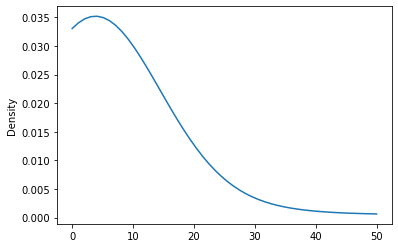

In [113]:
df_success['currentratio'].plot.density(ind=np.linspace(0, 50))

<AxesSubplot:ylabel='Density'>

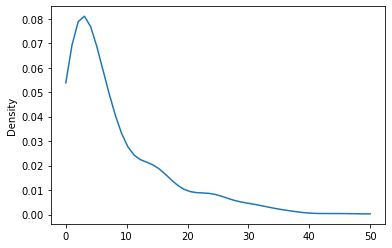

In [114]:
df_failed['currentratio'].plot.density(ind=np.linspace(0, 50))

Currentratio is a measure of liquidity of the company. It is calculated by dividing total current asset by total current liability, higher the ratio the more capabable the company is to pay off its debt. We can see successful company's distribution is skewed higher as can see in the difference in distribution which fits the expactation that the more capable a company is to pay off debt the more likely they will succeed

<AxesSubplot:ylabel='Density'>

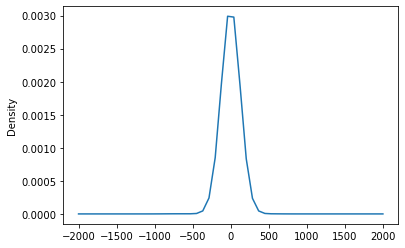

In [115]:
df_success['ebitdagrowth'].plot.density(ind=np.linspace(-2000, 2000))

<AxesSubplot:ylabel='Density'>

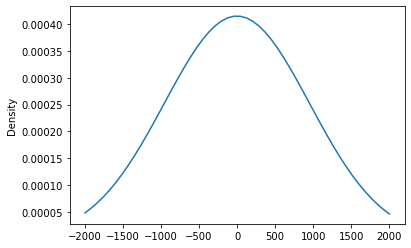

In [116]:
df_failed['ebitdagrowth'].plot.density(ind=np.linspace(-2000, 2000))

EBITDA is earnign before interest, tax, depreciation, and amortization. It helps to measure the net income before all the other capital expenses. EBITDA Growth is measuring its growth year on year and we can see successful company actually have a more volatile growth. they tend to grow or fall a lot. failed company just mostly doesnt have any changes signaling these company probably didnt take on more riskly project that could really hurt their growth but also without the benefit from these riskier project

<AxesSubplot:ylabel='Density'>

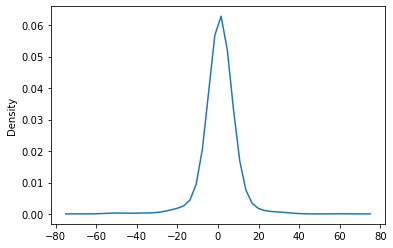

In [117]:
df_success['investedcapitalturnover'].plot.density(ind=np.linspace(-75, 75))

<AxesSubplot:ylabel='Density'>

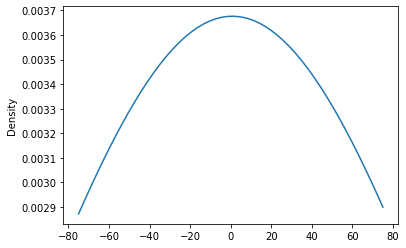

In [118]:
df_failed['investedcapitalturnover'].plot.density(ind=np.linspace(-75, 75))

Invested capital is the total amount of money raised by a company by issuing securities to shareholders and bondholders, and invested capital is calculated by adding the total debt and capital lease obligations to the amount of equity issued to investors. Invested capital is not a line item in company's financial statement because debt, capital leases and stockholders equity are each listed separately in the balance sheet. We can see more successful company have a wider distribution. The reason it goes into negative is that total revenue can be negative. So if ignore the negative part we can just see failed company generally have a higer turnover ratio signaling it has less invested capital then total revenue than more successful company

<AxesSubplot:ylabel='Density'>

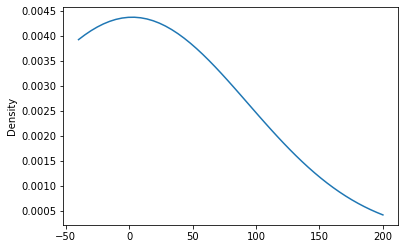

In [119]:
df_success['leverageratio'].plot.density(ind=np.linspace(-40, 200))

<AxesSubplot:ylabel='Density'>

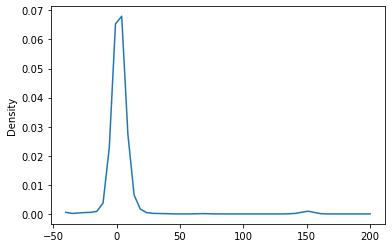

In [120]:
df_failed['leverageratio'].plot.density(ind=np.linspace(-40, 200))

Leverageratio is how much leverage a company take on. The way intrinio calculate it is divide total asset by debt so higher the number means actually more asset compare to debt so we can clearly see sucessful company have a higher ratio signaling they are less indebt

<AxesSubplot:ylabel='Density'>

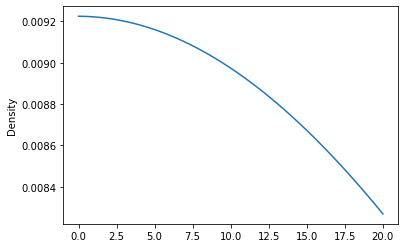

In [121]:
df_success['nnep'].plot.density(ind=np.linspace(0, 20))

<AxesSubplot:ylabel='Density'>

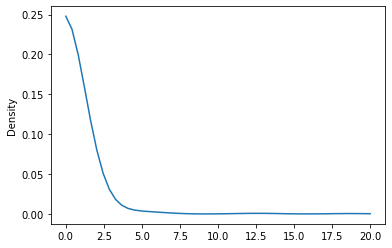

In [122]:
df_failed['nnep'].plot.density(ind=np.linspace(0, 20))

A non-operating expense is an expense incurred by a business that's unrelated to its core operations. The most common types of non-operating expenses relate to depreciation, amortization, interest charges or other costs of borrowing. Accountants sometimes remove non-operating expenses or non-operating revenues in order to examine the performance of the business, ignoring effects of financing or other irrelevant issues. Higher the ratio higher their non-operating expenses. so we can see successful company have a higher ratio


<AxesSubplot:ylabel='Density'>

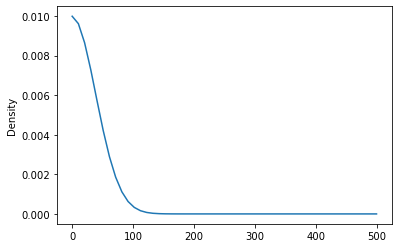

In [123]:
df_success['profitmargin'].plot.density(ind=np.linspace(0, 500))

<AxesSubplot:ylabel='Density'>

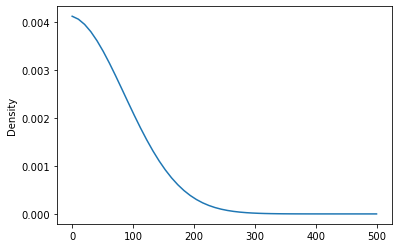

In [124]:
df_failed['profitmargin'].plot.density(ind=np.linspace(0, 500))

Profit margin is part of a category of profitability ratios and it measures how much out of every dollar of sales a company actually keeps in earnings. Higher ratio means higher profit so we can clearly see sucessful company have a higher profit margin

<AxesSubplot:ylabel='Density'>

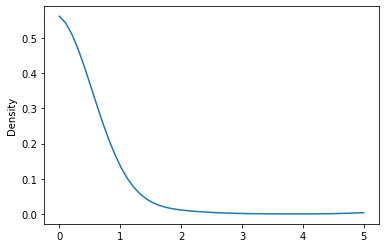

In [125]:
df_success['roe_simple'].plot.density(ind=np.linspace(0, 5))

<AxesSubplot:ylabel='Density'>

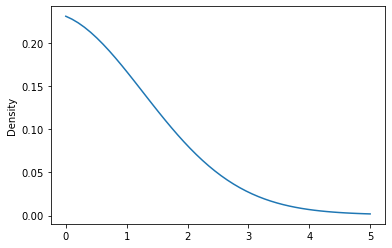

In [126]:
df_failed['roe_simple'].plot.density(ind=np.linspace(0, 5))

Return on equity (ROE_SIMPLE) is the amount of net income returned as a percentage of total equity. Return on equity measures a corporation's profitability by revealing how much profit a company generates with the money shareholders have invested. The ROE is useful for comparing the profitability of a company to that of other firms in the same industry. Failed company have a slighter higher distribution of ROE

<AxesSubplot:ylabel='Density'>

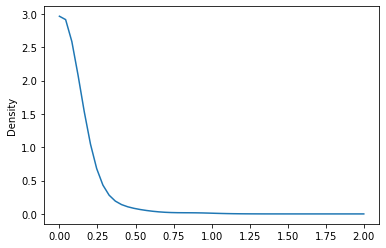

In [127]:
df_success['stdebttocap'].plot.density(ind=np.linspace(0, 2))

<AxesSubplot:ylabel='Density'>

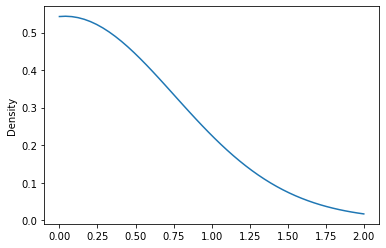

In [128]:
df_failed['stdebttocap'].plot.density(ind=np.linspace(0, 2))

stdebttocap is Short term / Total Capital, you can see failed company have a higher ditribution meaning on average they have a higher short term debt over total capital than sucessful company

In [129]:
df_success['enterprisevalue'] = df_success['enterprisevalue'].astype(float)
df_failed['enterprisevalue'] = df_failed['enterprisevalue'].astype(float)

<AxesSubplot:ylabel='Density'>

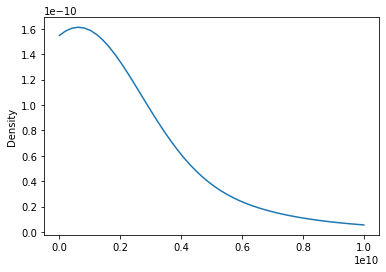

In [130]:
df_success['enterprisevalue'].plot.density(ind=np.linspace(0, 10000000000))

<AxesSubplot:ylabel='Density'>

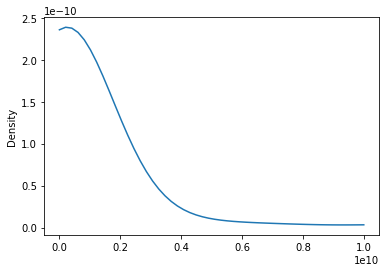

In [131]:
df_failed['enterprisevalue'].plot.density(ind=np.linspace(0, 10000000000))

Enterprise Value, or EV for short, is a measure of a company's total value, often used as a more comprehensive alternative to equity market capitalization. The market capitalization of a company is simply its share price multiplied by the number of shares a company has outstanding. Sucessful company generally distribute more toward the higher end


### Pandas Profiling

In [135]:
df_nums = df[['assetturnover',
       'commontocap', 'currentratio', 'ebitdagrowth', 
       'investedcapitalturnover',
       'leverageratio', 'nnep', 'profitmargin',
       'roe_simple', 'stdebttocap', 'enterprisevalue', 'employees',
       'security_delisted', 'sic', 'ipo_price', 'current_price']]

In [136]:
report =  pandas_profiling.ProfileReport(df_nums)

In [137]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [138]:
df.head()

,Date,Symbol,assetturnover,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,efftaxrate,fcffqoqgrowth,investedcapitalturnover,...,roe_simple,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success
0,2020-12-30,RSI,1.6674,0.231097,0.7344,-4.970785,NaN,NaN,NaN,-1.0316,...,2.130902,0.000000,6.634374e+08,United States of America,NaN,FALSE,7990,21.13,9.00,False
1,2020-12-24,VTAQ,NaN,-0.043767,7.9669,NaN,NaN,NaN,NaN,NaN,...,0.214396,0.000826,1.917886e+08,United States of America,4.0,FALSE,6770,10.29,10.07,True
2,2020-12-23,PHAR,0.5199,0.340220,5.5220,-0.037194,NaN,0.143971,NaN,0.8098,...,0.227771,0.000000,9.838328e+09,Netherlands,258.0,FALSE,2834,19.19,8.79,False
3,2020-12-23,VHAQ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,United States of America,2.0,FALSE,6770,10.15,10.04,True
4,2020-12-22,XL,0.1142,0.998900,38.0183,-3.426013,NaN,NaN,NaN,-0.2795,...,-0.320843,0.000582,1.677155e+09,United States of America,NaN,FALSE,3714,18.89,2.07,False


In [12]:
#saving new file
df.to_csv("preprocessed_data.csv", index = False, encoding = 'latin1')

In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn import metrics
from sklearn.model_selection import cross_val_score
import numpy as np
import matplotlib.pyplot as plt
from sklearn import tree
from sklearn import preprocessing

In [3]:
data = pd.read_csv("preprocessed_data.csv")

In [4]:
data.head()

,Date,Symbol,assetturnover,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,efftaxrate,investedcapitalturnover,leverageratio,...,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success,price_change_rate
0,2020-12-30,RSI,1.6674,0.231097,0.73440,-4.970785,-0.069725,NaN,-1.0316,-1.2496,...,0.000000,6.634374e+08,United States of America,0.0,FALSE,7990,21.13,9.00,False,-57.406531
1,2020-12-24,VTAQ,NaN,-0.043767,7.96690,-696.592147,1.039494,NaN,NaN,1.0512,...,0.000826,1.917886e+08,United States of America,4.0,FALSE,6770,10.29,10.07,True,-2.137998
2,2020-12-23,PHAR,0.5199,0.340220,5.52200,-0.037194,-20.545706,0.143971,0.8098,20.5393,...,0.000000,9.838328e+09,Netherlands,258.0,FALSE,2834,19.19,8.79,False,-54.194893
3,2020-12-23,VHAQ,NaN,0.139743,9.43082,-696.592147,1.039494,NaN,NaN,NaN,...,-0.104405,NaN,United States of America,2.0,FALSE,6770,10.15,10.04,True,-1.083744
4,2020-12-22,XL,0.1142,0.998900,38.01830,-3.426013,-2.499642,NaN,-0.2795,2.0335,...,0.000582,1.677155e+09,United States of America,0.0,FALSE,3714,18.89,2.07,False,-89.041821


In [5]:
data.isnull().sum()

Date                         0
Symbol                       0
assetturnover              524
commontocap                 14
currentratio                33
ebitdagrowth                23
ebitdaqoqgrowth            145
efftaxrate                 970
investedcapitalturnover    527
leverageratio              289
nnep                        13
profitmargin               515
roe_simple                  15
stdebttocap                 14
enterprisevalue            320
country                     45
employees                    0
security_delisted           11
sic                          0
ipo_price                    0
current_price                0
success                      0
price_change_rate            0
dtype: int64

In [6]:
data.replace("api_401", np.nan)

,Date,Symbol,assetturnover,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,efftaxrate,investedcapitalturnover,leverageratio,...,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success,price_change_rate
0,2020-12-30,RSI,1.6674,0.231097,0.734400,-4.970785,-0.069725,NaN,-1.0316,-1.2496,...,0.000000,6.634374e+08,United States of America,0.0,FALSE,7990,21.130000,9.000000,False,-57.406531
1,2020-12-24,VTAQ,NaN,-0.043767,7.966900,-696.592147,1.039494,NaN,NaN,1.0512,...,0.000826,1.917886e+08,United States of America,4.0,FALSE,6770,10.290000,10.070000,True,-2.137998
2,2020-12-23,PHAR,0.5199,0.340220,5.522000,-0.037194,-20.545706,0.143971,0.8098,20.5393,...,0.000000,9.838328e+09,Netherlands,258.0,FALSE,2834,19.190000,8.790000,False,-54.194893
3,2020-12-23,VHAQ,NaN,0.139743,9.430820,-696.592147,1.039494,NaN,NaN,NaN,...,-0.104405,NaN,United States of America,2.0,FALSE,6770,10.150000,10.040000,True,-1.083744
4,2020-12-22,XL,0.1142,0.998900,38.018300,-3.426013,-2.499642,NaN,-0.2795,2.0335,...,0.000582,1.677155e+09,United States of America,0.0,FALSE,3714,18.890000,2.070000,False,-89.041821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,2012-05-11,IRG,2.4524,0.702414,0.654000,0.170757,0.171005,0.167320,3.3931,3.1084,...,0.000000,3.413480e+08,NaN,461.0,TRUE,5812,16.850000,50.813333,True,201.562809
1297,2012-05-10,ADNC,1.3039,1.000000,6.416000,0.737988,0.187756,-0.079751,7.3652,1.2138,...,0.000000,3.534993e+07,United States of America,319.0,TRUE,3674,19.000000,31.749821,True,67.104319
1298,2012-04-27,EDG,0.3407,0.703960,1.653700,-0.208686,15.081761,0.504280,0.5024,1.7427,...,0.004761,8.156529e+09,South Africa,8964.0,FALSE,1040,10.350000,7.535000,True,-27.198068
1299,2012-04-18,SDR,NaN,0.583302,4.399244,0.956547,0.450718,NaN,NaN,NaN,...,0.005250,NaN,United States of America,9.0,FALSE,1311,4.683877,25.206667,True,438.158149


In [7]:
"api_401" in data

False

In [8]:
data.replace("api_500", np.nan)

,Date,Symbol,assetturnover,commontocap,currentratio,ebitdagrowth,ebitdaqoqgrowth,efftaxrate,investedcapitalturnover,leverageratio,...,stdebttocap,enterprisevalue,country,employees,security_delisted,sic,ipo_price,current_price,success,price_change_rate
0,2020-12-30,RSI,1.6674,0.231097,0.734400,-4.970785,-0.069725,NaN,-1.0316,-1.2496,...,0.000000,6.634374e+08,United States of America,0.0,FALSE,7990,21.130000,9.000000,False,-57.406531
1,2020-12-24,VTAQ,NaN,-0.043767,7.966900,-696.592147,1.039494,NaN,NaN,1.0512,...,0.000826,1.917886e+08,United States of America,4.0,FALSE,6770,10.290000,10.070000,True,-2.137998
2,2020-12-23,PHAR,0.5199,0.340220,5.522000,-0.037194,-20.545706,0.143971,0.8098,20.5393,...,0.000000,9.838328e+09,Netherlands,258.0,FALSE,2834,19.190000,8.790000,False,-54.194893
3,2020-12-23,VHAQ,NaN,0.139743,9.430820,-696.592147,1.039494,NaN,NaN,NaN,...,-0.104405,NaN,United States of America,2.0,FALSE,6770,10.150000,10.040000,True,-1.083744
4,2020-12-22,XL,0.1142,0.998900,38.018300,-3.426013,-2.499642,NaN,-0.2795,2.0335,...,0.000582,1.677155e+09,United States of America,0.0,FALSE,3714,18.890000,2.070000,False,-89.041821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,2012-05-11,IRG,2.4524,0.702414,0.654000,0.170757,0.171005,0.167320,3.3931,3.1084,...,0.000000,3.413480e+08,NaN,461.0,TRUE,5812,16.850000,50.813333,True,201.562809
1297,2012-05-10,ADNC,1.3039,1.000000,6.416000,0.737988,0.187756,-0.079751,7.3652,1.2138,...,0.000000,3.534993e+07,United States of America,319.0,TRUE,3674,19.000000,31.749821,True,67.104319
1298,2012-04-27,EDG,0.3407,0.703960,1.653700,-0.208686,15.081761,0.504280,0.5024,1.7427,...,0.004761,8.156529e+09,South Africa,8964.0,FALSE,1040,10.350000,7.535000,True,-27.198068
1299,2012-04-18,SDR,NaN,0.583302,4.399244,0.956547,0.450718,NaN,NaN,NaN,...,0.005250,NaN,United States of America,9.0,FALSE,1311,4.683877,25.206667,True,438.158149


In [9]:
"api_500" in data

False

In [10]:
for index, row in data.iterrows():
    if row['current_price'] <= row['ipo_price'] * 0.5 or row['security_delisted'] is True:
        data.loc[index,'success'] = False
    else:
        data.loc[index,'success'] = True

In [11]:
data = data.fillna(data.mean())

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


Decision Tree

In [12]:
data.columns

Index(['Date', 'Symbol', 'assetturnover', 'commontocap', 'currentratio',
       'ebitdagrowth', 'ebitdaqoqgrowth', 'efftaxrate',
       'investedcapitalturnover', 'leverageratio', 'nnep', 'profitmargin',
       'roe_simple', 'stdebttocap', 'enterprisevalue', 'country', 'employees',
       'security_delisted', 'sic', 'ipo_price', 'current_price', 'success',
       'price_change_rate'],
      dtype='object')

In [13]:
le = preprocessing.LabelEncoder()
le.fit(data['country'])
data['country_label'] = le.transform(data['country'])

In [14]:
X = data[['assetturnover', 'commontocap', 'currentratio', 'ebitdagrowth', 'investedcapitalturnover', 'leverageratio', 'nnep', 'profitmargin', 'roe_simple', 'stdebttocap', 'enterprisevalue', 'country_label', 'employees']]

In [15]:
X.head()

,assetturnover,commontocap,currentratio,ebitdagrowth,investedcapitalturnover,leverageratio,nnep,profitmargin,roe_simple,stdebttocap,enterprisevalue,country_label,employees
0,1.66740,0.231097,0.73440,-4.970785,-1.031600,-1.249600,-0.280635,-0.472693,2.130902,0.000000,6.634374e+08,43,0.0
1,2.63689,-0.043767,7.96690,-696.592147,1.218204,1.051200,-1.419520,-23.968938,0.214396,0.000826,1.917886e+08,43,4.0
2,0.51990,0.340220,5.52200,-0.037194,0.809800,20.539300,0.375965,0.230894,0.227771,0.000000,9.838328e+09,25,258.0
3,2.63689,0.139743,9.43082,-696.592147,1.218204,24.168069,-53.114658,-23.968938,-0.094776,-0.104405,2.765785e+09,43,2.0
4,0.11420,0.998900,38.01830,-3.426013,-0.279500,2.033500,-0.311163,-2.979939,-0.320843,0.000582,1.677155e+09,43,0.0


In [16]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1301 entries, 0 to 1300
Data columns (total 13 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   assetturnover            1301 non-null   float64
 1   commontocap              1301 non-null   float64
 2   currentratio             1301 non-null   float64
 3   ebitdagrowth             1301 non-null   float64
 4   investedcapitalturnover  1301 non-null   float64
 5   leverageratio            1301 non-null   float64
 6   nnep                     1301 non-null   float64
 7   profitmargin             1301 non-null   float64
 8   roe_simple               1301 non-null   float64
 9   stdebttocap              1301 non-null   float64
 10  enterprisevalue          1301 non-null   float64
 11  country_label            1301 non-null   int64  
 12  employees                1301 non-null   float64
dtypes: float64(12), int64(1)
memory usage: 132.3 KB


In [17]:
y = data[["success"]]

In [18]:
y.head()

,success
0,False
1,True
2,False
3,True
4,False


In [19]:
X.isnull().sum()

assetturnover              0
commontocap                0
currentratio               0
ebitdagrowth               0
investedcapitalturnover    0
leverageratio              0
nnep                       0
profitmargin               0
roe_simple                 0
stdebttocap                0
enterprisevalue            0
country_label              0
employees                  0
dtype: int64

In [20]:
def cross_val(max_depth, X = X, y = y):
  scores_lst = []
  accuracy = []
  scores_mean = []
  for i in range(1,max_depth+1):
      model = tree.DecisionTreeClassifier(max_depth = i)
      scores = cross_val_score(estimator = model, X = X, y=y, cv=10)
      scores_lst.append((i,round(scores.mean(),4)))
      accuracy.append(model.fit(X, y).score(X, y))
      scores_mean.append(scores.mean())

  return scores_lst, accuracy, scores_mean

In [21]:
def visualize_scores(depth,accuracy, scores_mean):
  fig, ax = plt.subplots(1,1, figsize=(15,5))
  ax.plot(depth, scores_mean, '-*', label='mean cross-validation accuracy', alpha=0.9)
  ax.plot(depth, accuracy, '-o', label='train accuracy', alpha=0.9)
  ax.set_title("Accuracy compared to tree depth", fontsize=16)
  ax.set_xlabel('Tree depth', fontsize=14)
  ax.set_ylabel('Accuracy', fontsize=14)
  ax.set_xticks(depth)
  ax.legend()

In [22]:
max = 21
scores, accuracy, scores_mean = cross_val(max, X, y)

In [23]:
print(scores)

[(1, 0.6456), (2, 0.6495), (3, 0.6933), (4, 0.6948), (5, 0.6941), (6, 0.6979), (7, 0.684), (8, 0.6841), (9, 0.6764), (10, 0.6756), (11, 0.681), (12, 0.6718), (13, 0.671), (14, 0.6649), (15, 0.6648), (16, 0.6664), (17, 0.6795), (18, 0.6502), (19, 0.6587), (20, 0.6656), (21, 0.6602)]


In [24]:
print(accuracy)

[0.6533435818601077, 0.6971560338201384, 0.7317448116833205, 0.7486548808608763, 0.7694081475787855, 0.8063028439661799, 0.8308993082244427, 0.8424289008455035, 0.8639508070714835, 0.889315910837817, 0.9023827824750192, 0.9254419677171407, 0.9315910837817064, 0.9423520368946964, 0.9554189085318986, 0.9777094542659492, 0.9554189085318986, 0.994619523443505, 0.9884704073789393, 0.9961568024596464, 0.9969254419677172]


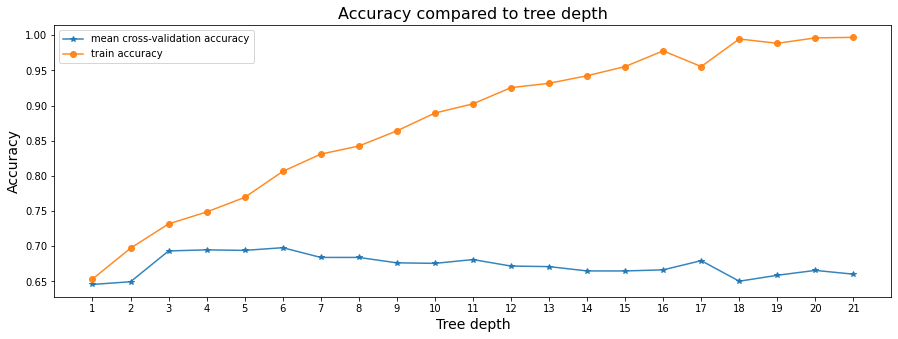

In [25]:
range1 = range(1,max+1)
visualize_scores(range1,accuracy,scores_mean)

In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

In [27]:
model = tree.DecisionTreeClassifier(max_depth=4).fit(X_train, y_train)

def run_single_tree(model, X_train, y_train, X_test, y_test, depth):
    accuracy_train = model.score(X_train, y_train)
    accuracy_test = model.score(X_test, y_test)
    print('Single tree depth: ', depth)
    print('Accuracy, Training Set: ', round(accuracy_train*100,5), '%')
    print('Accuracy, Test Set: ', round(accuracy_test*100,5), '%')
    return accuracy_train, accuracy_test
  

# train and evaluate a 5-depth tree
sm_best_tree_accuracy_train, sm_best_tree_accuracy_test = run_single_tree(model, X_train, y_train, 
                                                                          X_test, y_test, 
                                                                          4)

Single tree depth:  4
Accuracy, Training Set:  73.84615 %
Accuracy, Test Set:  67.81609 %


KNN Model

In [28]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier

In [29]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
%matplotlib inline 

#elbow analysis
dis_score = []
K = range(1,6)
for k in K:
    kmodel = KMeans(n_clusters = k)
    kmodel.fit(X_test)
    dis_score.append(kmodel.inertia_)

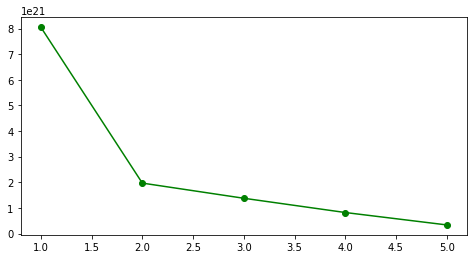

In [30]:
plt.figure(figsize =(8,4))
plt.plot(K, dis_score, 'go-')
plt.show()

In [31]:
knn = KNeighborsClassifier(n_neighbors = 2)
knn.fit(X_train, y_train)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


KNeighborsClassifier(n_neighbors=2)

In [32]:
Y_pred = knn.predict(X_test)
accuracy = round(knn.score(X_train, y_train) * 100, 2)
print("Accuracy:",accuracy)

Accuracy: 79.9


Support Vector Machine (SVM)

In [33]:
from sklearn import svm
clf = svm.SVC(kernel='rbf', random_state = 109, C=1.0)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/sklearn/utils/validation.py:985: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [34]:
accuracy = round(knn.score(X_train, y_train) * 100, 2)
print("Accuracy:",accuracy)

Accuracy: 79.9


Random Forest

In [1]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn import preprocessing
from sklearn import metrics
import pandas as pd
import numpy as np

In [3]:
df = pd.read_csv(r"preprocessed_data.csv")

In [4]:
for index, row in df.iterrows():
    if row['current_price'] <= row['ipo_price']*0.5 or row['security_delisted'] is True:
        df.loc[index,'success'] = False
    else:
        df.loc[index,'success'] = True

In [5]:
df = df.fillna(df.mean())

C:\Users\13170\AppData\Local\Temp/ipykernel_19732/114435927.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df = df.fillna(df.mean())


In [6]:
le = preprocessing.LabelEncoder()
le.fit(df['country'])
df['country_label'] = le.transform(df['country'])

In [7]:
x = df[['assetturnover', 'commontocap', 'currentratio', 'ebitdagrowth', 'investedcapitalturnover', 'leverageratio', 'nnep', 'profitmargin', 'roe_simple', 'stdebttocap', 'enterprisevalue', 'country_label', 'employees']]
y = df['success']

In [8]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2)

In [9]:
clf=RandomForestClassifier(n_estimators=100)
clf.fit(x_train,y_train)

RandomForestClassifier()

In [10]:
y_pred = clf.predict(x_test)

In [11]:
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
print("Recall:",metrics.recall_score(y_test, y_pred))
print("Precision:",metrics.precision_score(y_test, y_pred))
print("F1:",metrics.f1_score(y_test, y_pred))

Accuracy: 0.6318681318681318
Recall: 0.525
Precision: 0.5915492957746479
F1: 0.5562913907284769
